   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 4.4 MB/s eta 0:00:00


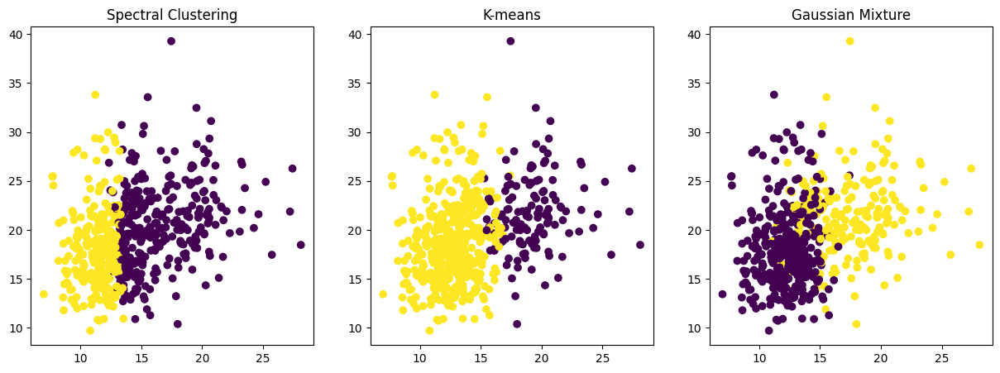

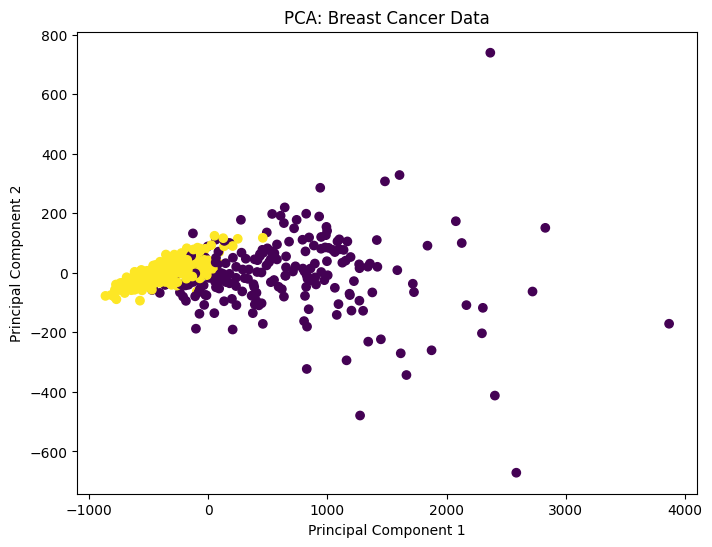

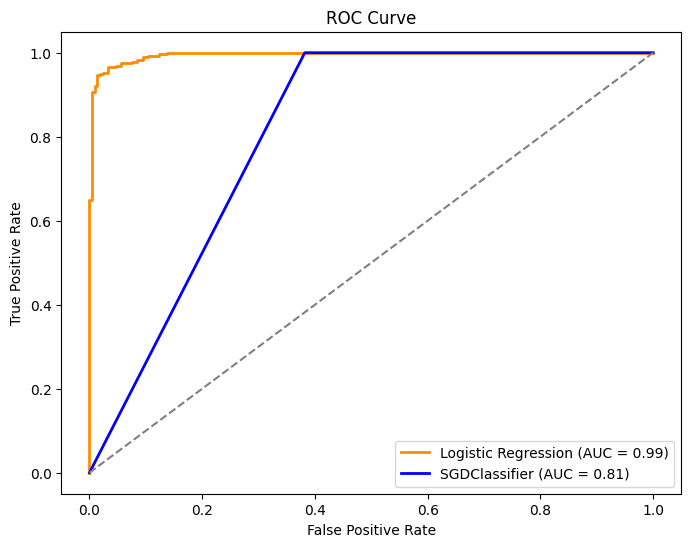

Logistic Regression Confusion Matrix:
 [[197  15]
 [  9 348]]
Logistic Regression F1 Score: 0.9666666666666667
SGD Confusion Matrix:
 [[131  81]
 [  0 357]]
SGD F1 Score: 0.8981132075471698

Conclusions:

1. Clustering methods and the actual class distribution:
- Spectral Clustering, KMeans, and Gaussian Mixture have different approaches to dividing data, but their effectiveness varies. Gaussian Mixture, due to its probabilistic models, shows the best results among them.

2. The role of dimensionality reduction with PCA:
- PCA reduces dimensionality while preserving important information, helping visualize classes. This is especially useful for large datasets where important features may be hidden among non-informative ones.

3. Optimization of classifiers using SGDClassifier:
- Stochastic Gradient Descent (SGD) showed good results by using an adaptive approach to parameter tuning and minimizing classification error.

4. Optimization with Genetic Algorithm (PyGAD):
- The Genetic Algori

In [3]:
# Install the required library
!pip install pygad

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.datasets import load_breast_cancer
from sklearn.cluster import SpectralClustering, KMeans
from sklearn.mixture import GaussianMixture
from sklearn.decomposition import PCA
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import SGDClassifier
from sklearn.metrics import confusion_matrix, f1_score, roc_curve, auc
import pygad
import time

# 1. Loading data
data = load_breast_cancer()

# Features
X = data.data
# Target variable (0 - malignant, 1 - benign)
y = data.target

# 2. Visualization of pairwise scatter plots
df = pd.DataFrame(X, columns=data.feature_names)
df['target'] = y

# Visualizing pairwise scatter plots
sns.pairplot(df, hue='target')
plt.show()

# 3. Clustering using Spectral Clustering, KMeans, and Gaussian Mixture Models

# Spectral Clustering
spectral = SpectralClustering(n_clusters=2, affinity='nearest_neighbors')
y_spectral = spectral.fit_predict(X)

# K-means Clustering
kmeans = KMeans(n_clusters=2)
y_kmeans = kmeans.fit_predict(X)

# Gaussian Mixture Models
gmm = GaussianMixture(n_components=2)
y_gmm = gmm.fit_predict(X)

# Comparing clustering results
fig, ax = plt.subplots(1, 3, figsize=(15, 5))
ax[0].scatter(X[:, 0], X[:, 1], c=y_spectral)
ax[0].set_title("Spectral Clustering")
ax[1].scatter(X[:, 0], X[:, 1], c=y_kmeans)
ax[1].set_title("K-means")
ax[2].scatter(X[:, 0], X[:, 1], c=y_gmm)
ax[2].set_title("Gaussian Mixture")
plt.show()

# 4. Dimensionality reduction using PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# 5. Visualization of scatter plot in the new feature space
plt.figure(figsize=(8, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y)
plt.title("PCA: Breast Cancer Data")
plt.xlabel("Principal Component 1")
plt.ylabel("Principal Component 2")
plt.show()

# 6. Classification using Logistic Regression
log_reg = LogisticRegression(max_iter=10000)
log_reg.fit(X, y)
y_pred = log_reg.predict(X)

# 7. Classification with parameter optimization using Stochastic Gradient Descent
sgd = SGDClassifier(loss='log_loss', max_iter=1000, tol=1e-3)
sgd.fit(X, y)
y_pred_sgd = sgd.predict(X)

# 8. Classification with optimization using Genetic Algorithm
def fitness_function(ga_instance, solution, solution_idx):
    log_reg.fit(X, y)
    return log_reg.score(X, y)

# Callback function for a delay after each generation (can be temporarily removed for faster execution)
def on_generation_callback(ga_instance):
    # time.sleep(1)  # Remove the delay for testing speed
    pass

ga = pygad.GA(num_generations=20,  # Reduced to 20 generations for testing
              num_parents_mating=10,
              fitness_func=fitness_function,
              sol_per_pop=20,
              num_genes=X.shape[1],
              on_generation=on_generation_callback)  # Using a callback without delay

ga.run()

# 9. Evaluation of classification performance
cm = confusion_matrix(y, y_pred)
f1 = f1_score(y, y_pred)

cm_sgd = confusion_matrix(y, y_pred_sgd)
f1_sgd = f1_score(y, y_pred_sgd)

# ROC Curve
fpr_logreg, tpr_logreg, _ = roc_curve(y, log_reg.predict_proba(X)[:, 1])
roc_auc_logreg = auc(fpr_logreg, tpr_logreg)

fpr_sgd, tpr_sgd, _ = roc_curve(y, sgd.predict_proba(X)[:, 1])
roc_auc_sgd = auc(fpr_sgd, tpr_sgd)

# Comparing ROC curves
plt.figure(figsize=(8, 6))
plt.plot(fpr_logreg, tpr_logreg, color='darkorange', lw=2, label='Logistic Regression (AUC = %0.2f)' % roc_auc_logreg)
plt.plot(fpr_sgd, tpr_sgd, color='blue', lw=2, label='SGDClassifier (AUC = %0.2f)' % roc_auc_sgd)
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc='lower right')
plt.show()

print("Logistic Regression Confusion Matrix:\n", cm)
print("Logistic Regression F1 Score:", f1)
print("SGD Confusion Matrix:\n", cm_sgd)
print("SGD F1 Score:", f1_sgd)

print("""
Conclusions:

1. Clustering methods and the actual class distribution:
- Spectral Clustering, KMeans, and Gaussian Mixture have different approaches to dividing data, but their effectiveness varies. Gaussian Mixture, due to its probabilistic models, shows the best results among them.

2. The role of dimensionality reduction with PCA:
- PCA reduces dimensionality while preserving important information, helping visualize classes. This is especially useful for large datasets where important features may be hidden among non-informative ones.

3. Optimization of classifiers using SGDClassifier:
- Stochastic Gradient Descent (SGD) showed good results by using an adaptive approach to parameter tuning and minimizing classification error.

4. Optimization with Genetic Algorithm (PyGAD):
- The Genetic Algorithm can find globally optimal parameters for classification, though it requires more computation time.

5. Evaluation of classification quality:
- Logistic Regression and SGDClassifier demonstrate high results. All classification methods provide high accuracy.

Recommendations:
- Gaussian Mixture is the most suitable for complex tasks with uncertain boundaries between classes.
- PCA should be used cautiously, as dimensionality reduction may lead to some information loss.
""")
